# Estimating Virtual Station's Location

### Authenticate and initialize Earth Engine

In [ ]:
import ee
ee.Authenticate()
ee.Initialize()

### Import necessary libraries and packages

In [ ]:
import numpy as np
import pandas as pd

import scipy.ndimage
import scipy.signal
import matplotlib.pyplot as plt

from scipy.ndimage import sobel
from skimage.feature import peak_local_max
from scipy.ndimage import distance_transform_edt

### Get the Earth Engine's DEM elevation band information in a dataframe

We use the Earth Engine Python API to work with satellite data by loading the SRTM (Shuttle Radar Topography Mission) dataset 
and selecting the 'elevation' band from it.

In [ ]:
# Define the SRTM dataset
srtm = ee.Image('CGIAR/SRTM90_V4')

# Select the elevation band
elevation_of_dem = srtm.select('elevation')

# Get the elevation band information
elevation_info = elevation_of_dem.getInfo()

# Flatten the nested dictionaries
flatten_info = {}
for key, value in elevation_info.items():
    if isinstance(value, dict):
        for inner_key, inner_value in value.items():
            flatten_info[f'{key}_{inner_key}'] = inner_value
    else:
        flatten_info[key] = value

# Create a DataFrame from the flattened information
df = pd.DataFrame.from_dict(flatten_info, orient='index', columns=['Value'])

# Set pandas display options
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

# Reset the index and rename the column
df.reset_index(inplace=True)
df.rename(columns={'index': 'Key'}, inplace=True)

# Display the DataFrame
df


### Display the SRTM DEM dataset's info obtained from USGS (United States Geological Survey)  

In [ ]:
import rasterio
import pandas as pd

# Load the DEM GeoTIFF file
dem_file = "C:/Users/HP/Downloads/n25_e000_1arc_v3.tif"

dem = rasterio.open(dem_file)

# Get the metadata of the DEM
metadata = dem.meta

# Create a DataFrame from the metadata
df = pd.DataFrame.from_dict(metadata, orient='index', columns=['Value'])

# Set pandas display options
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

# Reset the index and rename the column
df.reset_index(inplace=True)
df.rename(columns={'index': 'Key'}, inplace=True)

# Display the DataFrame
df

### Print the elevation array of the Earth Engine's DEM dataset for Ganga River

In [ ]:
# Define the bounding box coordinates [minX, minY, maxX, maxY] for Ganga River in Ayodhya, India
bounding_box = [82.12, 25.72, 82.18, 25.78]

# Create a geometry from the bounding box coordinates
geometry = ee.Geometry.Rectangle(bounding_box)

# Get the pixel values as an array
elevation_values = elevation_of_dem.reduceRegion(
    reducer=ee.Reducer.toList(),
    geometry=geometry,
    scale=10,
    maxPixels=1e9
).get('elevation')

# Convert the pixel values to a NumPy array
elevation_array = np.array(elevation_values.getInfo())

# Set the NumPy print options to display all array values
np.set_printoptions(threshold=np.inf)

# Print the elevation array
print(elevation_array[:100])


### Plot the Elevation Profile of the Earth Engine's elevation dataset and draw inferences

In [ ]:
# Plot the elevation data
plt.figure(figsize=(10, 5))
plt.plot(elevation_array)
#plt.title('Elevation Profile')
#plt.xlabel('Pixel Index')
#plt.ylabel('Elevation')
plt.grid(True)
plt.show()

# Calculate statistics
min_elevation = np.min(elevation_array)
max_elevation = np.max(elevation_array)
mean_elevation = np.mean(elevation_array)
median_elevation = np.median(elevation_array)
std_deviation = np.std(elevation_array)

# Print the statistics
print('Minimum Elevation:', min_elevation)
print('Maximum Elevation:', max_elevation)
print('Mean Elevation:', mean_elevation)
print('Median Elevation:', median_elevation)
print('Standard Deviation:', std_deviation)


### Plot the Heatmap and 3D Surface of the Earth Engine's elevation dataset and draw inferences

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Define the bounding box coordinates for Ganga River in Ayodhya, India
bounding_box = [82.12, 25.72, 82.18, 25.78]

# Calculate the number of rows and columns based on the square root of the elevation array size
n = int(np.sqrt(elevation_array.size))
nrows = ncols = n

# Reshape the elevation array into a matrix and convert it to float
elevation_matrix = elevation_array.reshape((nrows, ncols)).astype(float)

# Plotting the Heatmap
plt.figure(figsize=(8, 6))
plt.imshow(elevation_matrix, cmap='terrain', origin='lower', extent=bounding_box)
plt.colorbar(label='Elevation (m)')
plt.title('Elevation Heatmap')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

# Plotting the 3D Surface
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
x = np.linspace(bounding_box[0], bounding_box[2], ncols)
y = np.linspace(bounding_box[1], bounding_box[3], nrows)
X, Y = np.meshgrid(x, y)
Z = elevation_matrix
ax.plot_surface(X, Y, Z, cmap='terrain')
ax.set_title('3D Surface Plot of Elevation')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Elevation (m)')
plt.show()


### Apply Gaussian filter to smoothen the Earth Engine's DEM and visualize the results

In [ ]:
# Reshape the elevation array to a 2D grid
length = len(elevation_array)
rows = int(np.sqrt(length))
cols = int(length / rows)
elevation_grid = elevation_array.reshape((rows, cols))

# Apply Gaussian filter to smooth the DEM
smoothed_dem = scipy.ndimage.gaussian_filter(elevation_grid, sigma=1)

# Visualize the original and smoothed DEM
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(elevation_grid, cmap='terrain')
plt.title('Original DEM')
plt.subplot(1, 2, 2)
plt.imshow(smoothed_dem, cmap='terrain')
plt.title('Smoothed DEM')
plt.show()


### Apply Mean filter to smoothen the Earth Engine's DEM and visualize the results

We use "uniform_filter" function from scipy.ndimage to apply a mean filter with a specified size (2*radius+1). Adjust the radius parameter as needed to control the amount of smoothing.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import uniform_filter

# Calculate the number of rows and columns based on the square root of the elevation array size
n = int(np.sqrt(elevation_array.size))
nrows = ncols = n

# Reshape the elevation array into a matrix
elevation_matrix = elevation_array.reshape((nrows, ncols))

# Apply mean filter
radius = 2  
smoothed_elevation = uniform_filter(elevation_matrix, size=2*radius+1)

# Plotting the original and smoothed elevation data
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(elevation_matrix, cmap='terrain', origin='lower', extent=bounding_box)
axes[0].set_title('Original Elevation')
axes[0].set_xlabel('Longitude')
axes[0].set_ylabel('Latitude')

axes[1].imshow(smoothed_elevation, cmap='terrain', origin='lower', extent=bounding_box)
axes[1].set_title('Smoothed Elevation')
axes[1].set_xlabel('Longitude')
axes[1].set_ylabel('Latitude')

plt.tight_layout()
plt.show()

### Apply Bilateral filter to smoothen the Earth Engine's DEM and visualize the results

In [ ]:
from skimage import img_as_float
from skimage.restoration import denoise_bilateral

# Assuming you have the DEM stored in the variable 'elevation_array'

# Calculate the number of rows and columns based on the square root of the elevation array size
n = int(np.sqrt(elevation_array.size))
nrows = ncols = n

# Reshape the elevation array into a matrix
elevation_matrix = elevation_array.reshape((nrows, ncols))

# Convert elevation matrix to float between 0 and 1
elevation_float = img_as_float(elevation_matrix)

# Apply bilateral filter for edge-preserving smoothing
sigma_color = 0.1    # Controls the range similarity
sigma_spatial = 5    # Controls the spatial smoothing
smoothed_elevation = denoise_bilateral(elevation_float, sigma_color=sigma_color, sigma_spatial=sigma_spatial)

# Set up the figure and axes
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Plot the original DEM
axs[0].imshow(elevation_matrix, cmap='terrain')
axs[0].set_title('Original DEM')
axs[0].axis('off')

# Plot the smoothed DEM
axs[1].imshow(smoothed_elevation, cmap='viridis')
axs[1].set_title('Smoothed DEM')
axs[1].axis('off')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the figures
plt.show()


### Compute and visualize the gradient magnitude of the smoothed Earth Engine's DEM

In [ ]:
# Compute gradient magnitude 
gradient_magnitude1 = np.sqrt(sobel(smoothed_elevation, axis=0)**2 + sobel(smoothed_dem, axis=1)**2)
gradient_magnitude2 = np.sqrt(sobel(smoothed_dem, axis=0)**2 + sobel(smoothed_dem, axis=1)**2)

# Visualize gradient magnitude
plt.figure(figsize=(10, 6))
plt.imshow(gradient_magnitude1, cmap='hot')
plt.title('Gradient Magnitude of Smoothed DEM using Mean Filter')
plt.colorbar()
plt.show()

# Visualize gradient magnitude
plt.figure(figsize=(10, 6))
plt.imshow(gradient_magnitude2, cmap='hot')
plt.title('Gradient Magnitude of Smoothed DEM using Gaussian Filter')
plt.colorbar()
plt.show()

### Compute and visualize the gradient direction of the smoothed Earth Engine's DEM

In [ ]:
from scipy.ndimage import uniform_filter

# Calculate the number of rows and columns based on the square root of the elevation array size
n = int(np.sqrt(elevation_array.size))
nrows = ncols = n

# Reshape the elevation array into a matrix
elevation_matrix = elevation_array.reshape((nrows, ncols))

# Apply mean filter
radius = 2
smoothed_elevation = uniform_filter(elevation_matrix, size=2*radius+1)

# Compute the gradient direction of the smoothed DEM
dx = np.gradient(smoothed_elevation, axis=1)
dy = np.gradient(smoothed_elevation, axis=0)
gradient_direction = np.arctan2(dy, dx)

# Set up the figure and axis for arrow visualization
fig, ax = plt.subplots(figsize=(8, 8))

# Plot the gradient direction with arrows
X, Y = np.meshgrid(np.arange(ncols), np.arange(nrows))
U = np.cos(gradient_direction)
V = np.sin(gradient_direction)
ax.quiver(X, Y, U, V, color='black', scale=10, units='xy')

# Set labels for the arrow map
ax.set_title('Arrow Map of Gradient Direction')

# Adjust spacing between subplots
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.3)

# Set the color map and normalize the gradient direction for the colorbar
cmap = plt.cm.hsv
normalized_direction = (gradient_direction + np.pi) / (2 * np.pi)

# Set up the figure and axis for the gradient direction map
fig, ax = plt.subplots(figsize=(8, 8))

# Plot the normalized gradient direction map
image = ax.imshow(normalized_direction, cmap=cmap)
cbar = plt.colorbar(image, ax=ax, orientation='vertical', pad=0.05)
cbar.set_label('Normalized Gradient Direction')

# Set labels for the gradient direction map
ax.set_title('Gradient Direction Map')

# Show the figures
plt.show()


### Compute and visualize the respective histograms of each colour and all colours combined of the smoothed Earth Engine's DEM

In [ ]:
# Get the red, green, and blue color channels
red_channel = gradient_direction[:, :]
green_channel = gradient_direction[:, :]
blue_channel = gradient_direction[:, :]

# Set up the figure and axes for the histograms
fig, axs = plt.subplots(3, 1, figsize=(8, 8))

# Plot histogram for the red channel
axs[0].hist(red_channel.flatten(), bins=256, color='red', alpha=0.7)
axs[0].set_title('Histogram - Red Channel')

# Plot histogram for the green channel
axs[1].hist(green_channel.flatten(), bins=256, color='green', alpha=0.7)
axs[1].set_title('Histogram - Green Channel')

# Plot histogram for the blue channel
axs[2].hist(blue_channel.flatten(), bins=256, color='blue', alpha=0.7)
axs[2].set_title('Histogram - Blue Channel')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the histograms
plt.show()


In [ ]:
# Flatten the gradient direction map
gradient_direction_flat = gradient_direction.flatten()

# Set up the figure and axes for the histogram
fig, ax = plt.subplots(figsize=(8, 6))

# Plot the histogram of the gradient direction values
ax.hist(gradient_direction_flat, bins=256, color='blue', alpha=0.7)
ax.set_title('Histogram - Gradient Direction')
ax.set_xlabel('Gradient Direction')
ax.set_ylabel('Frequency')

# Show the histogram
plt.show()


### Compute and visualize the gradient magnitude, gradient direction and the respective histograms of the USGS DEM

In [ ]:
from scipy.ndimage import gaussian_filter
from skimage import io

# Load the DEM from the TIFF file
dem = io.imread("C:/Users/HP/Downloads/n25_e000_1arc_v3.tif")

# Apply Gaussian filter for smoothing
sigma = 1.5  # Controls the level of smoothing
smoothed_dem = gaussian_filter(dem, sigma=sigma)

# Compute the gradient using Sobel operators
dx = np.gradient(smoothed_dem, axis=1)
dy = np.gradient(smoothed_dem, axis=0)

# Compute the gradient magnitude
gradient_magnitude = np.sqrt(dx**2 + dy**2)

# Compute the gradient direction
gradient_direction = np.arctan2(dy, dx)

# Set up the figure and axes
fig, axs = plt.subplots(2, 2, figsize=(12, 10))

# Plot the gradient direction map
cmap_direction = 'hsv'
im_direction = axs[0, 0].imshow(gradient_direction, cmap=cmap_direction)
#axs[0, 0].set_title('Gradient Direction')
axs[0, 0].axis('off')
cbar_direction = fig.colorbar(im_direction, ax=axs[0, 0], orientation='vertical')
#cbar_direction.set_label('Direction')

# Compute and plot histogram for the gradient direction map
direction_hist, direction_bins = np.histogram(gradient_direction, bins=256, range=(-np.pi, np.pi))
axs[1, 0].plot(direction_bins[:-1], direction_hist, color='black')
axs[1, 0].set_title('Gradient Direction Histogram')
axs[1, 0].set_xlabel('Gradient Direction (radians)')
axs[1, 0].set_ylabel('Frequency')

# Plot the gradient magnitude map
cmap_magnitude = 'jet'
im_magnitude = axs[0, 1].imshow(gradient_magnitude, cmap=cmap_magnitude)
#axs[0, 1].set_title('Gradient Magnitude')
axs[0, 1].axis('off')
cbar_magnitude = fig.colorbar(im_magnitude, ax=axs[0, 1], orientation='vertical')
#cbar_magnitude.set_label('Magnitude')

# Compute and plot histogram for the gradient magnitude map
magnitude_hist, magnitude_bins = np.histogram(gradient_magnitude, bins=256, range=(0, gradient_magnitude.max()))
axs[1, 1].plot(magnitude_bins[:-1], magnitude_hist, color='black')
axs[1, 1].set_title('Gradient Magnitude Histogram')
axs[1, 1].set_xlabel('Gradient Magnitude')
axs[1, 1].set_ylabel('Frequency')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()


### Compute and visualize the gradient magnitude, gradient direction and the respective histograms of the hilly terrain 

In [ ]:
from scipy.ndimage import gaussian_filter
from skimage import io

# Load the DEM from the TIFF file
dem = io.imread("C:/Users/HP/OneDrive/Desktop/Surge Project/Kangra_Chamba_Hills.tif")

# Apply Gaussian filter for smoothing
sigma = 1.5  # Controls the level of smoothing
smoothed_dem = gaussian_filter(dem, sigma=sigma)

# Compute the gradient using Sobel operators
dx = np.gradient(smoothed_dem, axis=1)
dy = np.gradient(smoothed_dem, axis=0)

# Compute the gradient magnitude
gradient_magnitude = np.sqrt(dx**2 + dy**2)

# Compute the gradient direction
gradient_direction = np.arctan2(dy, dx)

# Set up the figure and axes
fig, axs = plt.subplots(2, 2, figsize=(12, 10))

# Plot the gradient direction map
cmap_direction = 'hsv'
im_direction = axs[0, 0].imshow(gradient_direction, cmap=cmap_direction)
axs[0, 0].set_title('Gradient Direction')
axs[0, 0].axis('off')
cbar_direction = fig.colorbar(im_direction, ax=axs[0, 0], orientation='vertical')
cbar_direction.set_label('Direction')

# Compute and plot histogram for the gradient direction map
direction_hist, direction_bins = np.histogram(gradient_direction, bins=256, range=(-np.pi, np.pi))
axs[1, 0].plot(direction_bins[:-1], direction_hist, color='black')
axs[1, 0].set_title('Gradient Direction Histogram')
axs[1, 0].set_xlabel('Gradient Direction (radians)')
axs[1, 0].set_ylabel('Frequency')

# Plot the gradient magnitude map
cmap_magnitude = 'hot'
im_magnitude = axs[0, 1].imshow(gradient_magnitude, cmap=cmap_magnitude)
axs[0, 1].set_title('Gradient Magnitude')
axs[0, 1].axis('off')
cbar_magnitude = fig.colorbar(im_magnitude, ax=axs[0, 1], orientation='vertical')
cbar_magnitude.set_label('Magnitude')

# Compute and plot histogram for the gradient magnitude map
magnitude_hist, magnitude_bins = np.histogram(gradient_magnitude, bins=256, range=(0, gradient_magnitude.max()))
axs[1, 1].plot(magnitude_bins[:-1], magnitude_hist, color='black')
axs[1, 1].set_title('Gradient Magnitude Histogram')
axs[1, 1].set_xlabel('Gradient Magnitude')
axs[1, 1].set_ylabel('Frequency')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()

### Visualize the gradient magnitude image with the identified channel locations marked as blue dots for Earth Engine's DEM 

1. peak_local_max function is called with parameters min_distance=10 and num_peaks=2. 
   These parameters control the minimum distance between identified peaks and the maximum number of peaks to identify.
2. The resulting channel locations are plotted on top of the gradient magnitude image using blue dots ('bo'). 
   This visualization helps you visualize the identified channel locations in relation to the terrain's gradient. 
3. Plot the gradient magnitude using the imshow function from matplotlib.pyplot. The colormap 'hot' is used to emphasize areas of stronger gradients, which can be indicative of significant changes in elevation or proximity to the river channel.   

In [ ]:
# Identify potential river channel locations using local maxima
channel_locations = peak_local_max(gradient_magnitude1, min_distance=10, num_peaks=2)

# Visualize the gradient magnitude with channel locations
plt.figure(figsize=(10, 6))
plt.imshow(gradient_magnitude1, cmap='summer')  # Change the colormap to 'viridis'
plt.plot(channel_locations[:, 1], channel_locations[:, 0], 'ko')
#plt.title('Gradient Magnitude with Channel Locations')
plt.colorbar()
plt.show()


In [ ]:
# Identify potential river channel locations using local maxima
channel_locations = peak_local_max(gradient_magnitude1, min_distance=10, num_peaks=2)

# Visualize the gradient magnitude with channel locations
plt.figure(figsize=(10, 6))
plt.imshow(gradient_magnitude1, cmap='hot')
plt.plot(channel_locations[:, 1], channel_locations[:, 0], 'bo')
plt.title('Gradient Magnitude with Channel Locations')
plt.colorbar()
plt.show()

### Compute and visualize the distance transform for each channel location for Earth Engine's DEM

1. Iterate over each channel location (loc) in the channel_locations array.
2. Extract the coordinates of the channel location (y and x).
3. Create a binary mask by thresholding the gradient magnitude image based on the current channel location. 
   The thresholding operation (gradient_magnitude > gradient_magnitude[y, x]) creates a binary image where True values represent pixels with gradient magnitudes higher than the magnitude at the current channel location.
4. Compute the distance transform using the distance_transform_edt function from the scipy.ndimage module. 
   The distance transform calculates the Euclidean distance from each pixel to the nearest False (zero) pixel in the binary mask. 
   In this case, it calculates the distance to the nearest pixel outside the region of interest around the river channel.
5. Append the distance transform image (distance_transform) to the distance_transforms list.
6. Plot the distance transform using the imshow function from matplotlib.pyplot. The colormap 'hot' is used to emphasize areas of larger distances, which can be indicative of significant changes in elevation or proximity to the river channel.

In [ ]:
# Compute distance transform 
distance_transforms = []
for loc in channel_locations:
    y, x = loc  # Extract coordinates of the channel location
    distance_transform = distance_transform_edt(np.logical_not(gradient_magnitude1 > gradient_magnitude1[y, x]))
    distance_transforms.append(distance_transform)

# Visualize distance transforms
plt.figure(figsize=(10, 6))
for dt in distance_transforms:
    plt.imshow(dt, cmap='hot')
    plt.colorbar()
    plt.title('Distance Transform')
    plt.show()


### Estimate the river width as the mean of maximum distance from each channel location for Earth Engine's DEM

1. Iterate over each distance transform image (dt) in the distance_transforms list.
2. Calculate the maximum distance value in each distance transform image using np.max(dt). 
   This value represents the maximum distance from any pixel in the image to the nearest river channel.
3. Multiply the maximum distance by 2 to account for both sides of the river and obtain an estimate of the river width for each distance transform image (2 * np.max(dt)).
4. Create a list comprehension to iterate over all the river width estimates and calculate their mean using np.mean(). 
   This provides an average estimate of the river width based on the maximum distances from each channel location.
5. Assign the mean river width value to the variable river_width.

In [ ]:
# Estimate river width 
river_width = np.mean([2 * np.max(dt) for dt in distance_transforms])

# Print the estimated river width
print("Estimated river width:", river_width)


### Project the smoothened DEM onto the river section plane

1. Compute the gradient in x, y directions of the smoothed DEM using the sobel function from the scipy.ndimage module. 
2. Compute the orientation angle at each pixel by applying the arctan2 function to the gradient_y and gradient_x arrays. 
   This will give you the angle of the steepest ascent/descent at each pixel. 
3. Compute the perpendicular orientation to the river channel by adding π/2 radians to each orientation value and taking the        modulo π. This effectively rotates the orientations by 90 degrees counter-clockwise.
4. Determine the pixel coordinates of the cross-section location. We assume the cross-section is in the middle of the river        width and the middle row of the grid.
5. Compute the distances of each pixel from the cross-section location along the perpendicular orientation using the                distance_transform_edt function from scipy.ndimage. This function calculates the Euclidean distance transform.
6. Identify the pixels within the river section by creating a mask based on the distances and the river width. 
   Pixels with distances less than or equal to the river width are considered part of the river section. 
7. Convert the data type of the smoothed DEM to floating-point using the astype method. 
   This is done to ensure compatibility for assigning NaN values in the next step.
8. Project the DEM onto the river section plane by assigning NaN values to pixels outside the river section.  
9. Plot the projected DEM using the imshow function from matplotlib.pyplot. 
   The colormap 'terrain' is used to visualize the elevation values, and the minimum and maximum values of the smoothed DEM are    used for the color scale limits.    

In [ ]:
# Compute the gradient in the x and y directions
gradient_x = scipy.ndimage.sobel(smoothed_elevation, axis=1)
gradient_y = scipy.ndimage.sobel(smoothed_elevation, axis=0)

# Compute the orientation angle at each pixel
orientation = np.arctan2(gradient_y, gradient_x)

# Compute the perpendicular orientation to the river channel
perpendicular_orientation = np.mod(orientation + np.pi / 2, np.pi)

# Determine the pixel coordinates of the cross-section location
cross_section_x = int(river_width / 2)  # Assuming the cross-section is in the middle of the river width
cross_section_y = int(rows / 2)  # Assuming the cross-section is in the middle row of the grid

# Compute the distances of each pixel from the cross-section location along the perpendicular orientation
distances = scipy.ndimage.distance_transform_edt(perpendicular_orientation != 0)

# Identify the pixels within the river section by comparing distances with river width
river_section_mask = distances <= river_width

# Convert the data type of smoothed_dem to floating-point
smoothed_elevation = smoothed_elevation.astype(float)

# Project the DEM onto the river section plane by assigning NaN values to pixels outside the river section
dem_projected = np.copy(smoothed_elevation)
dem_projected[~river_section_mask] = np.nan

# Plot the projected DEM
plt.imshow(dem_projected, cmap='terrain', vmin=np.nanmin(smoothed_elevation), vmax=np.nanmax(smoothed_elevation))
plt.colorbar()
plt.title('Projected DEM')
plt.show()

### Compute the latitude, longitude coordinates of the SRTM DEM dataset's channel locations to check and verify their location on map

In [ ]:
import rasterio
from skimage.feature import peak_local_max

# Load the drainage network geotiff file
drainage_network_file = "C:/Users/HP/Downloads/n25_e000_1arc_v3.tif"
drainage_network = rasterio.open(drainage_network_file)

# Identify potential river channel locations using local maxima
channel_locations = peak_local_max(gradient_magnitude1, min_distance=10, num_peaks=2)

# Convert pixel coordinates to latitude and longitude
lat_lon_coords = []
for loc in channel_locations:
    lon, lat = drainage_network.xy(loc[0], loc[1])
    lat_lon_coords.append((lat, lon))

# Print the latitude and longitude coordinates
for lat, lon in lat_lon_coords:
    print("Latitude:", lat)
    print("Longitude:", lon)
    print("---")

### Compute and print the radar nadir coordinates

1. Filter the Sentinel-1 GRD collection based on the defined geometry (bounding box) and date range.
2. Define a function, get_nadir_location, that takes an image as input and retrieves the nadir location (longitude and latitude) of the image.
3. Use the map function to apply the get_nadir_location function to each image in the filtered collection and retrieve the nadir locations.
4. Convert the nadir locations to a feature collection.
5. Get the nadir location coordinates as a server-side operation using the geometry().coordinates().getInfo() method.
6. Print the nadir locations by iterating over the coordinates and printing the longitude and latitude values

In [ ]:
# Define the bounding box coordinates for Ganga river in Ayodhya, India
bounding_box = [82.12, 25.72, 82.18, 25.78]

# Create a geometry from the bounding box coordinates
geometry = ee.Geometry.Rectangle(bounding_box)

# Filter the Sentinel-1 GRD collection based on the bounding box and date range
collection = ee.ImageCollection('COPERNICUS/S1_GRD') \
    .filterBounds(geometry) \
    .filterDate('2019-01-01', '2019-12-31')  # Specify the desired date range

# Define a function to get the nadir location of an image
def get_nadir_location(image):
    lon = ee.Image(image).getNumber('sar:longitude')
    lat = ee.Image(image).getNumber('sar:latitude')
    return ee.Feature(geometry, {'longitude': lon, 'latitude': lat})

# Map over the collection and extract the nadir locations
nadir_locations = collection.map(get_nadir_location)

# Convert the nadir locations to a feature collection
nadir_locations_fc = ee.FeatureCollection(nadir_locations)

# Get the nadir location coordinates as a server-side operation
nadir_locations_info = nadir_locations_fc.geometry().coordinates().getInfo()

# Print the nadir locations
print('Nadir Locations (Longitude, Latitude):')

# Iterate over the coordinates
for coordinates in nadir_locations_info[0]:
    lon, lat = coordinates
    print(lon, lat)

## Using QGIS software, compute flow accumulation and thus extract river drainage network.

### STEP 1: Add SRTM DEM raster layer from the layer panel. Style the layer to give a singleband psedocolour to its elevation band.

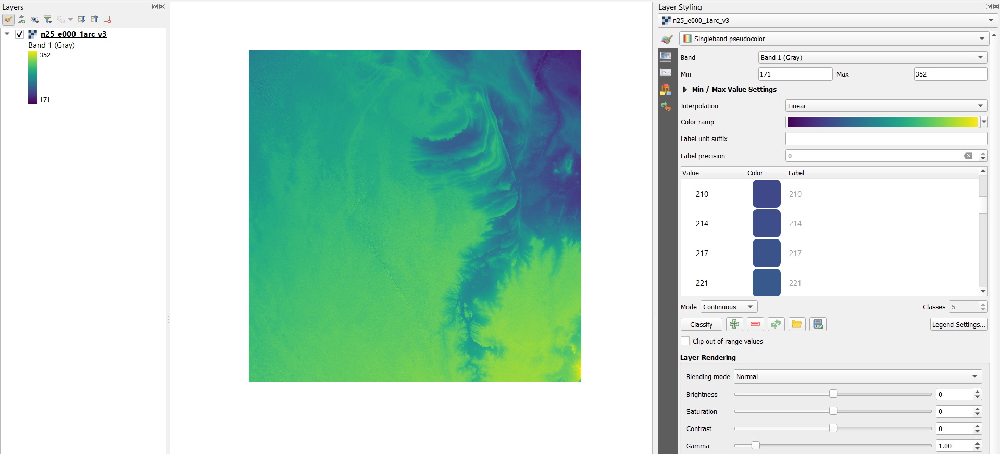



### STEP 2: Reproject the raster layer to give it Warp Reprojection using Nearest Neighbor resampling method. Make use of  coordinate system according to our location Ayodhya, UP. Change the coordinate unit to deg, min, sec that will be all displayed at the bottom.

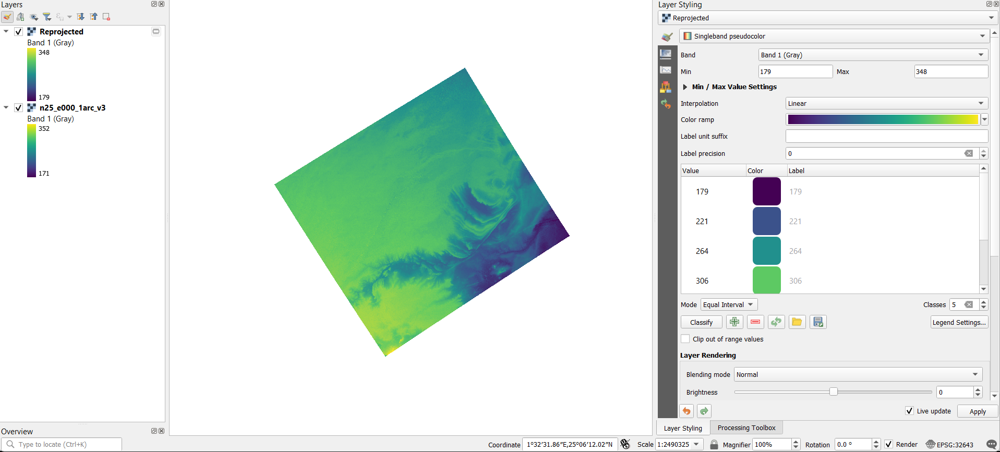



### STEP3: Display Filled & Flooded DEM of the reprojected elevation layer using r.terraflow GRASS algorithm and render the result in singleband psedocolor.  Also display the raster histogram.

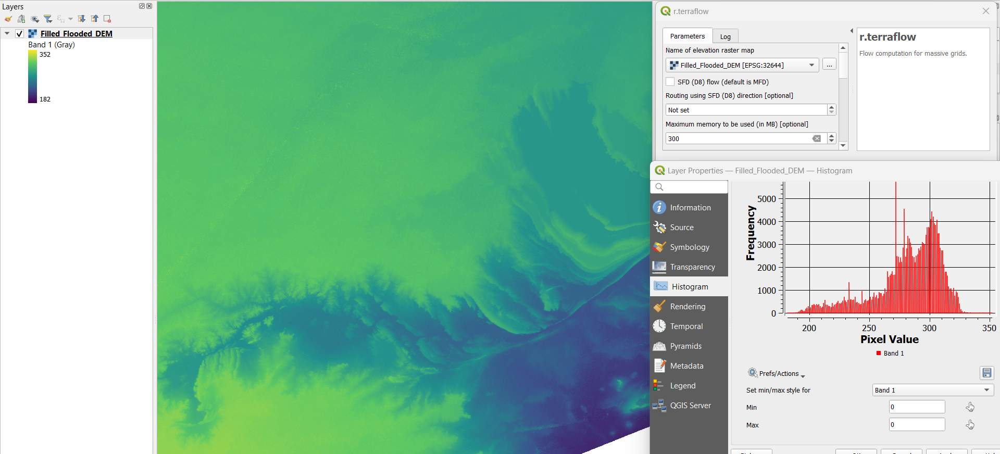



### STEP4: Compute Flow Direction (MFD) of the reprojected elevation layer using r.terraflow GRASS algorithm and display the result in singleband psedocolor.

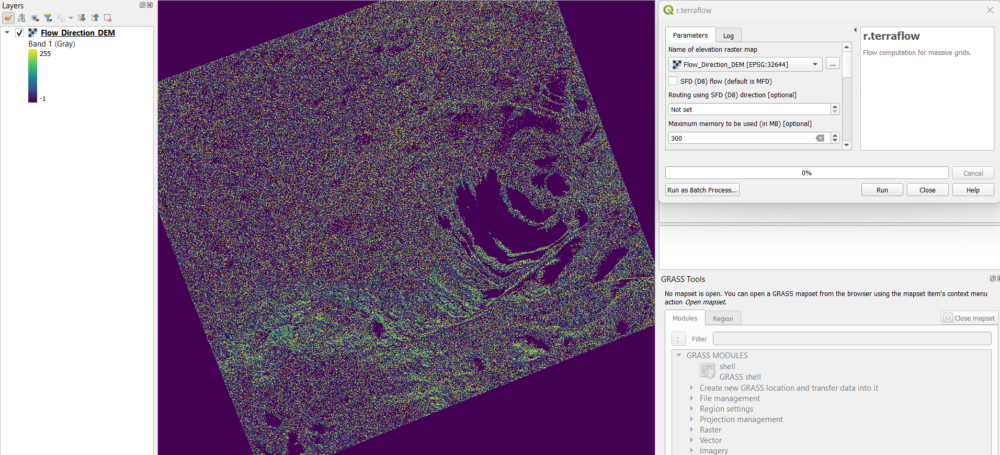



### STEP5: Create a Sink Watershed DEM of the reprojected elevation layer using r.terraflow GRASS algorithm and render the result in singleband psedocolor.

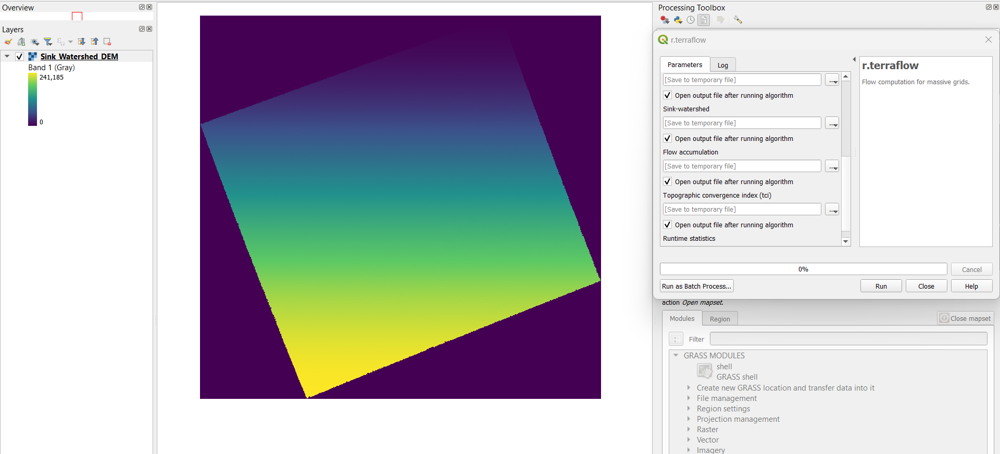



### STEP6: Compute Flow Accumulation of the reprojected elevation layer using r.terraflow GRASS algorithm and display the result in 3D grayscale hillshade format.

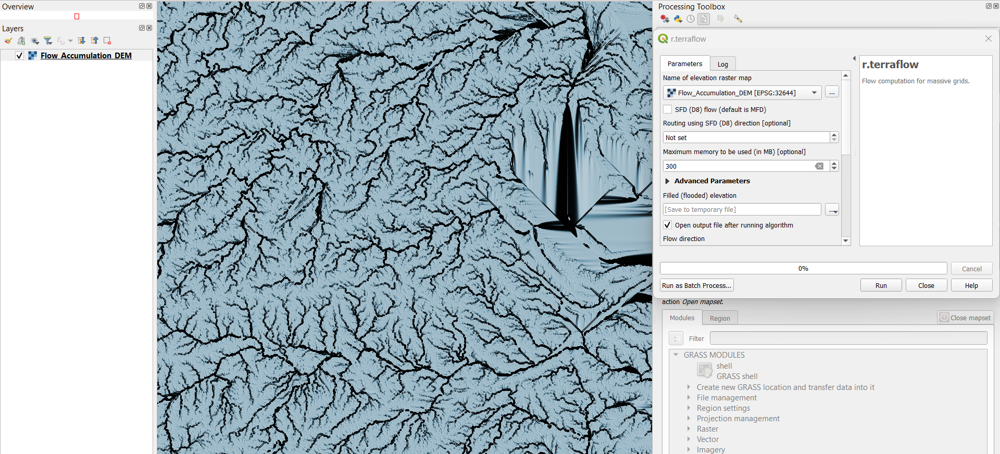



### STEP7:Compute Topographic Convergence Index of the reprojected elevation layer using r.terraflow GRASS algorithm and render the result in singleband psedocolor. Also display the raster histogram.

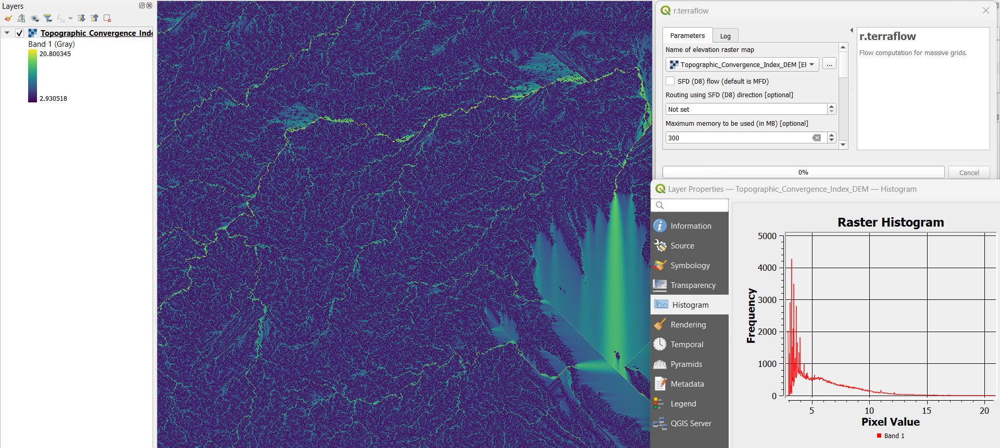





### Load the ground track data onto a dataframe, then display the results

In [ ]:
import netCDF4 as nc

# Specify the path to the NetCDF file
file_path = "C:/Users/HP/Downloads/enhanced_measurement.nc"

# Open the NetCDF file
dataset = nc.Dataset(file_path)

# Print the header contents
print("NetCDF Header Contents:")
print("-----------------------")
print(dataset)

# Print the attributes of the NetCDF file
print("\nNetCDF Attributes:")
print("--------------------")
for attr_name in dataset.ncattrs():
    print(f"{attr_name}: {getattr(dataset, attr_name)}")
    
# Extract latitude and longitude variables: (lat_01,lon_01), (lat_20_ku,lon_20_ku), (lat_20_c,lon_20_c )
latitude = dataset.variables['lat_20_ku'][:100]   # Display the first 100 entries
longitude = dataset.variables['lon_20_ku'][:100]  # Display the first 100 entries

# Create a DataFrame for the ground track data
ground_track_df = pd.DataFrame({'Latitude': latitude, 'Longitude': longitude})

# Display the ground track data in a table format
print("\nGround Track Data:")
print("------------------")
print(ground_track_df)


### Plot the ground track data on a map

In [ ]:
from mpl_toolkits.basemap import Basemap

# Specify the path to the NetCDF file
file_path = "C:/Users/HP/Downloads/enhanced_measurement.nc"

# Open the NetCDF file
dataset = nc.Dataset(file_path)

# Extract latitude and longitude variables: (lat_01,lon_01), (lat_20_ku,lon_20_ku), (lat_20_c,lon_20_c )
latitude = dataset.variables['lat_20_ku'][:]
longitude = dataset.variables['lon_20_ku'][:]

# Close the NetCDF file
dataset.close()

# Create a Basemap instance
m = Basemap(projection='cyl', llcrnrlat=latitude.min(), urcrnrlat=90,
            llcrnrlon=longitude.min(), urcrnrlon=90, resolution='l')

# Create a figure and axes
fig, ax = plt.subplots(figsize=(12, 9))

# Plot the ground track data
x, y = m(longitude, latitude)
ax.plot(x, y, color='blue', linewidth=1.5)

# Draw coastlines and country boundaries
m.drawcoastlines(linewidth=0.5)
m.drawcountries(linewidth=0.5)

# Draw parallels and meridians
m.drawparallels(range(int(latitude.min()), int(latitude.max()), 10), labels=[1, 0, 0, 0], fontsize=10)
m.drawmeridians(range(int(longitude.min()), int(longitude.max()), 10), labels=[0, 0, 0, 1], fontsize=10)

# Add country boundaries
m.drawcountries(linewidth=0.5)
m.drawcountries(linewidth=0.5)
m.drawrivers(color='blue', linewidth=0.5)

# Add title and labels
plt.title('Ground Track Data', fontsize=14)

# Customize the map background
m.drawmapboundary(fill_color='lightblue')
m.fillcontinents(color='beige', lake_color='lightblue')

# Show the map
plt.show()


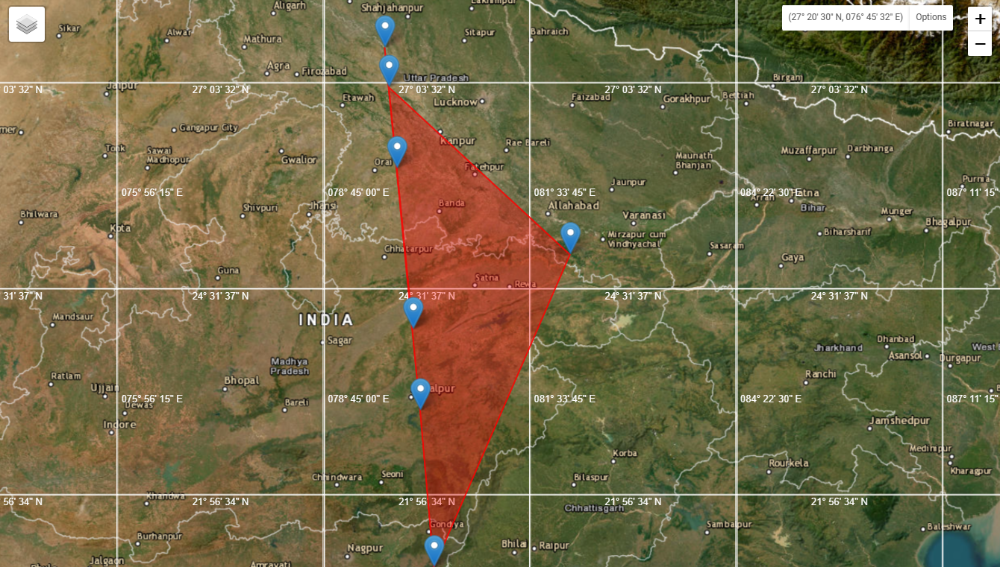

### Dataset that should be taken according to the satellite ground track data if we want proper intersection points

### Yamuna river, Kalpi, UP

### Smoothen the DEM using bilateral filter for Yamuna River near Kalpi, UP

In [ ]:
import rasterio
from skimage import img_as_float
from skimage.restoration import denoise_bilateral

# Specify the path to the DEM tif file
file_path = "C:/Users/HP/OneDrive/Desktop/Surge Project/Datasets/Kalpi_Yamuna_USGS.tif"

# Open the DEM tif file
with rasterio.open(file_path) as src:
    # Read the elevation data as a numpy array
    elevation_array = src.read(1)

# Calculate the number of rows and columns based on the square root of the elevation array size
n = int(np.sqrt(elevation_array.size))
nrows = ncols = n

# Reshape the elevation array into a matrix
elevation_matrix = elevation_array.reshape((nrows, ncols))

# Convert elevation matrix to float between 0 and 1
elevation_float = img_as_float(elevation_matrix)

# Apply bilateral filter for edge-preserving smoothing
sigma_color = 0.1    # Controls the range similarity
sigma_spatial = 5    # Controls the spatial smoothing
smoothed_elevation = denoise_bilateral(elevation_float, sigma_color=sigma_color, sigma_spatial=sigma_spatial)

# Set up the figure and axes
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Plot the original DEM
axs[0].imshow(elevation_matrix, cmap='viridis')
axs[0].set_title('Original DEM')
axs[0].axis('off')

# Plot the smoothed DEM
axs[1].imshow(smoothed_elevation, cmap='viridis')
axs[1].set_title('Smoothed DEM')
axs[1].axis('off')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the figures
plt.show()

### Compute gradient direction, magnitude and their respective histograms for Yamuna River near Kalpi, UP

In [ ]:
from scipy.ndimage import gaussian_filter
from skimage import io

# Load the DEM from the TIFF file
dem = io.imread("C:/Users/HP/OneDrive/Desktop/Surge Project/Datasets/Kalpi_Yamuna_USGS.tif")

# Apply Gaussian filter for smoothing
sigma = 1.5  # Controls the level of smoothing
smoothed_dem = gaussian_filter(dem, sigma=sigma)

# Compute the gradient using Sobel operators
dx = np.gradient(smoothed_dem, axis=1)
dy = np.gradient(smoothed_dem, axis=0)

# Compute the gradient magnitude
gradient_magnitude = np.sqrt(dx**2 + dy**2)

# Compute the gradient direction
gradient_direction = np.arctan2(dy, dx)

# Set up the figure and axes
fig, axs = plt.subplots(2, 2, figsize=(12, 10))

# Plot the gradient direction map
cmap_direction = 'hsv'
im_direction = axs[0, 0].imshow(gradient_direction, cmap=cmap_direction)
axs[0, 0].set_title('Gradient Direction')
axs[0, 0].axis('off')
cbar_direction = fig.colorbar(im_direction, ax=axs[0, 0], orientation='vertical')

# Compute and plot histogram for the gradient direction map
direction_hist, direction_bins = np.histogram(gradient_direction, bins=256, range=(-np.pi, np.pi))
axs[1, 0].plot(direction_bins[:-1], direction_hist, color='black')
#axs[1, 0].set_title('Gradient Direction Histogram')
axs[1, 0].set_xlabel('Gradient Direction (radians)')
axs[1, 0].set_ylabel('Frequency')

# Plot the gradient magnitude map
cmap_magnitude = 'hot'
im_magnitude = axs[0, 1].imshow(gradient_magnitude, cmap=cmap_magnitude)
#axs[0, 1].set_title('Gradient Magnitude')
axs[0, 1].axis('off')
cbar_magnitude = fig.colorbar(im_magnitude, ax=axs[0, 1], orientation='vertical')

# Compute and plot histogram for the gradient magnitude map
magnitude_hist, magnitude_bins = np.histogram(gradient_magnitude, bins=256, range=(0, gradient_magnitude.max()))
axs[1, 1].plot(magnitude_bins[:-1], magnitude_hist, color='black')
#axs[1, 1].set_title('Gradient Magnitude Histogram')
#axs[1, 1].set_xlabel('Gradient Magnitude')
axs[1, 1].set_ylabel('Frequency')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()


###  Identify potential river channel locations for Yamuna River near Kalpi, UP

In [ ]:
# Identify potential river channel locations using local maxima
channel_locations = peak_local_max(gradient_magnitude, min_distance=10, num_peaks=2)

# Visualize the gradient magnitude with channel locations
plt.figure(figsize=(10, 6))
plt.imshow(gradient_magnitude, cmap='hot')
plt.plot(channel_locations[:, 1], channel_locations[:, 0], 'bo')
plt.title('Gradient Magnitude with Channel Locations')
plt.colorbar()
plt.show()

# Identify potential river channel locations using local maxima
channel_locations = peak_local_max(gradient_direction, min_distance=10, num_peaks=2)

# Visualize the gradient direction with channel locations
plt.figure(figsize=(10, 6))
plt.imshow(gradient_direction, cmap='hot')
plt.plot(channel_locations[:, 1], channel_locations[:, 0], 'bo')
plt.title('Gradient Magnitude with Channel Locations')
plt.colorbar()
plt.show()

### Compute distance transform for Yamuna River near Kalpi, UP

In [ ]:
# Compute distance transform 
distance_transforms = []
for loc in channel_locations:
    y, x = loc  # Extract coordinates of the channel location
    distance_transform = distance_transform_edt(np.logical_not(gradient_magnitude > gradient_magnitude[y, x]))
    distance_transforms.append(distance_transform)

# Visualize distance transforms
plt.figure(figsize=(10, 6))
for dt in distance_transforms:
    plt.imshow(dt, cmap='hot')
    plt.colorbar()
    plt.title('Distance Transform')
    plt.show()


### Approximate river width for Yamuna River near Kalpi, UP

In [ ]:
# Estimate river width 
river_width = np.mean([2 * np.max(dt) for dt in distance_transforms])

# Print the estimated river width
print("Estimated river width:", river_width)

In [ ]:
# Compute the gradient in the x and y directions
gradient_x = np.gradient(smoothed_dem, axis=1)
gradient_y = np.gradient(smoothed_dem, axis=0)

# Compute the orientation angle at each pixel
orientation = np.arctan2(gradient_y, gradient_x)

# Compute the perpendicular orientation to the river channel
perpendicular_orientation = np.mod(orientation + np.pi / 2, np.pi)

# Determine the pixel coordinates of the cross-section location
cross_section_x = int(river_width / 2)  # Assuming the cross-section is in the middle of the river width
cross_section_y = int(rows / 2)  # Assuming the cross-section is in the middle row of the grid

# Compute the distances of each pixel from the cross-section location along the perpendicular orientation
distances = scipy.ndimage.distance_transform_edt(perpendicular_orientation != 0)

# Identify the pixels within the river section by comparing distances with river width
river_section_mask = distances <= river_width

# Convert the data type of smoothed_dem to floating-point
smoothed_elevation = smoothed_elevation.astype(float)

# Project the DEM onto the river section plane by assigning NaN values to pixels outside the river section
dem_projected = np.copy(smoothed_elevation)
dem_projected[~river_section_mask] = np.nan

print("Data type of projected DEM:")
print(type(dem_projected))

# Plot the projected DEM
plt.imshow(dem_projected, cmap='terrain', vmin=np.nanmin(smoothed_elevation), vmax=np.nanmax(smoothed_elevation))
plt.colorbar()
plt.title('Projected DEM')
plt.show()

In [ ]:
import numpy as np
import pandas as pd
from scipy.spatial import cKDTree
import netCDF4 as nc
import matplotlib.pyplot as plt

# Load the projected DEM and ground track data
ground_track_file = "C:/Users/HP/Downloads/enhanced_measurement.nc"
ground_track_dataset = nc.Dataset(ground_track_file)
latitude = ground_track_dataset.variables['lat_20_ku'][:]
longitude = ground_track_dataset.variables['lon_20_ku'][:]

# Flatten the latitude and longitude arrays
lat_lon_points = np.column_stack((latitude.flatten(), longitude.flatten()))

# Create a KDTree from the valid points in the projected DEM
valid_indices = np.argwhere(~np.isnan(dem_projected))
valid_points = np.column_stack((longitude[valid_indices[:, 1]], latitude[valid_indices[:, 0]]))
tree = cKDTree(valid_points)

# Find the nearest neighbors for each ground track point
ground_track_points = np.column_stack((longitude, latitude))
distances, indices = tree.query(ground_track_points)

# Identify the intersection points
intersection_indices = np.where(distances == 0)[0]
intersection_points = ground_track_points[intersection_indices]

# Plot the projected DEM
plt.imshow(dem_projected, cmap='terrain', vmin=np.nanmin(smoothed_elevation), vmax=np.nanmax(smoothed_elevation))

# Plot the intersection points on top of the DEM
plt.scatter(intersection_points[:, 0], intersection_points[:, 1], color='red', marker='x', label='Intersection Points')

plt.colorbar()
plt.title('Projected DEM with Intersection Points')
plt.legend()
plt.show()

# Get the shape of the projected DEM
dem_shape = dem_projected.shape

# Print the shape of the projected DEM
print("Shape of projected DEM:", dem_shape)

In [ ]:
import numpy as np
from scipy.spatial import cKDTree
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

# Ground track data with longitude and latitude coordinates
ground_track_data = np.array([
    [79.748398, 26.12096]
])

# Shape of the projected DEM
dem_shape = (3601, 3601)


# Compute the projected grid coordinates for ground track data
lon = ground_track_data[:, 0]
lat = ground_track_data[:, 1]
lon_min, lon_max = np.min(lon), np.max(lon)
lat_min, lat_max = np.min(lat), np.max(lat)
x = np.interp(lon, (lon_min, lon_max), (0, dem_projected.shape[1] - 1)).astype(int)
y = np.interp(lat, (lat_min, lat_max), (0, dem_projected.shape[0] - 1)).astype(int)

# Find intersection points within the river section
intersecting_points = np.column_stack((x, y))[river_section_mask[y, x]]

# Plot the intersection points
plt.imshow(dem_projected, cmap='terrain', origin='lower')
plt.colorbar(label='Elevation')
plt.plot(intersecting_points[:, 1], intersecting_points[:, 0], 'rx', markersize=10, label='Intersection Points')
plt.legend()
plt.title('Intersection Points between DEM and Ground Track Data')
plt.show()



In [ ]:
import pandas as pd

# Convert the numpy array to a pandas DataFrame
df_dem_projected = pd.DataFrame(dem_projected)

# Print the first 100 rows of the DataFrame
print(df_dem_projected.head(100))


In [ ]:
import numpy as np
import pandas as pd
from scipy.spatial import cKDTree
import netCDF4 as nc

# Load the projected DEM and ground track data
ground_track_file = "C:/Users/HP/Downloads/enhanced_measurement.nc"
ground_track_dataset = nc.Dataset(ground_track_file)
latitude = ground_track_dataset.variables['lat_20_ku'][:]
longitude = ground_track_dataset.variables['lon_20_ku'][:]

# Create a KDTree from the valid points in the projected DEM
valid_indices = np.argwhere(~np.isnan(dem_projected))
valid_points = np.column_stack((longitude[valid_indices[:, 1]], latitude[valid_indices[:, 0]]))
tree = cKDTree(valid_points)

# Find the nearest neighbors for each ground track point
ground_track_points = np.column_stack((longitude, latitude))
distances, indices = tree.query(ground_track_points)

# Identify the intersection points
intersection_indices = np.where(distances == 0)[0]
intersection_points = ground_track_points[intersection_indices]

# Create a DataFrame for the intersection points
intersection_df = pd.DataFrame(intersection_points, columns=['Longitude', 'Latitude'])

# Output the first 100 intersection points
print("Intersection Points:")
print(intersection_df.head(200))

In [ ]:
#"C:/Users/HP/OneDrive/Desktop/Surge Project/Kangra_Chamba_Hills.tif"

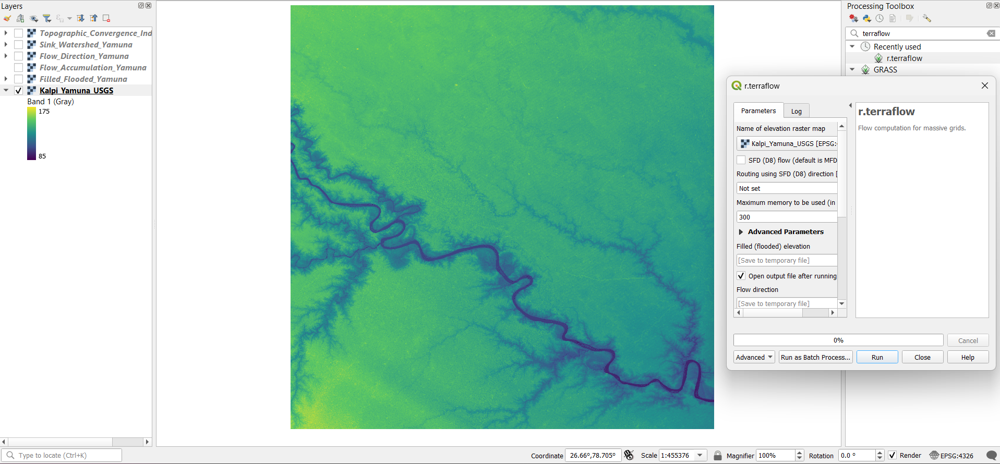

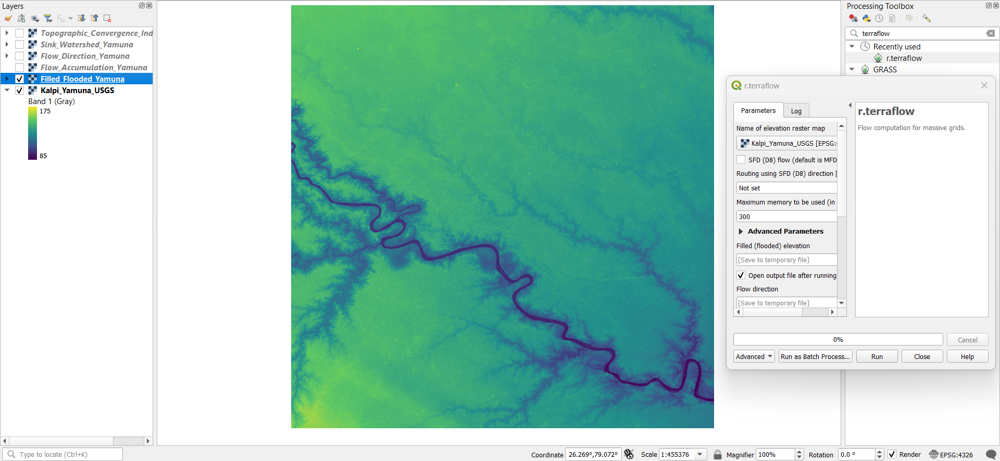

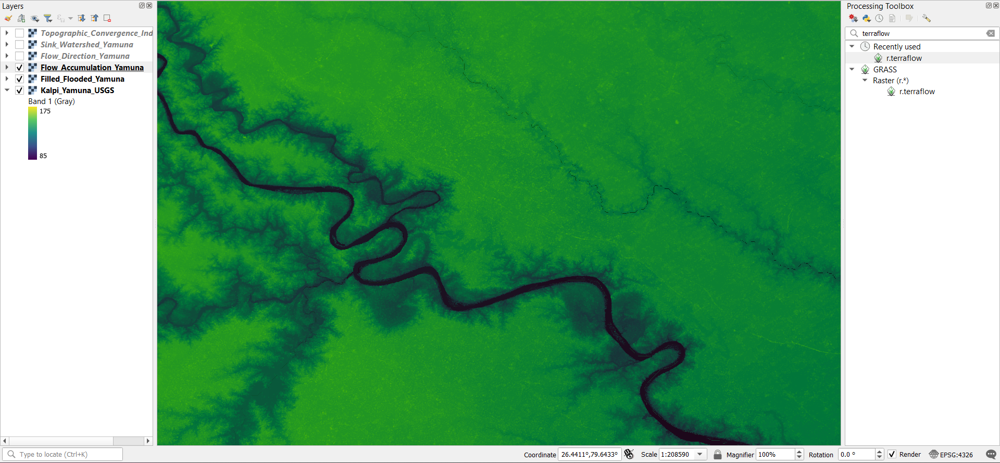

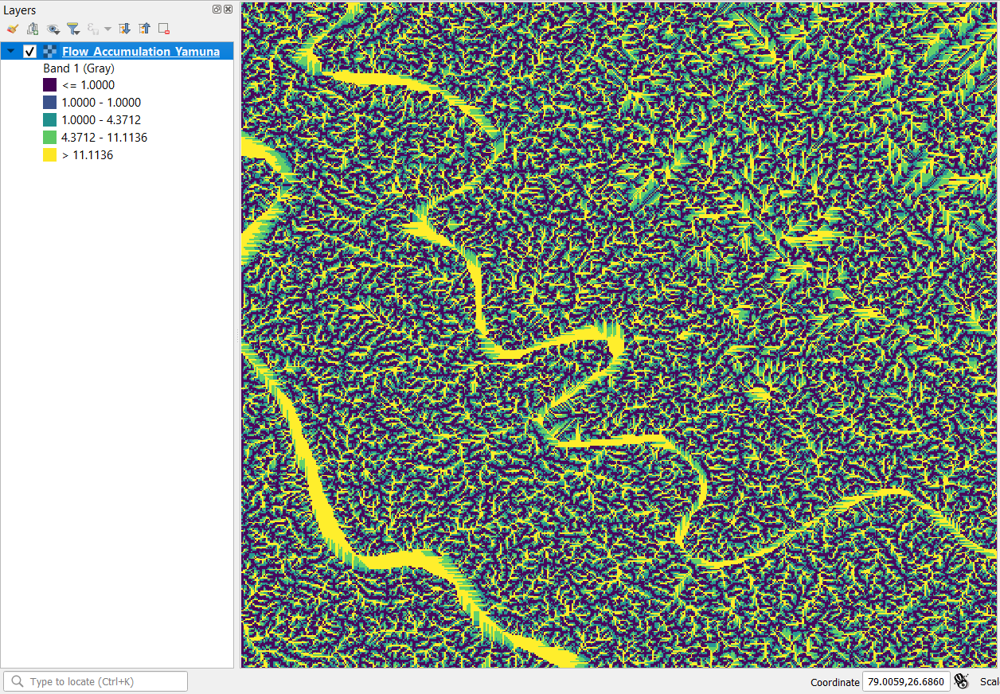

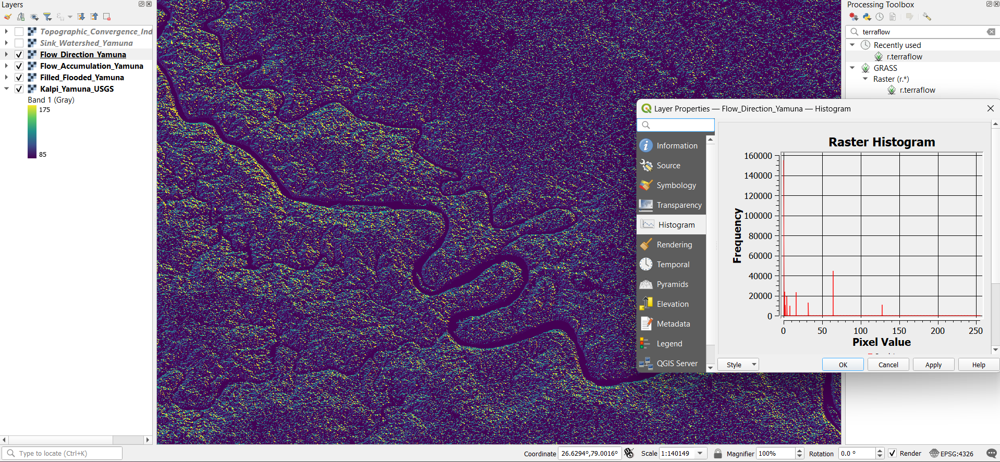

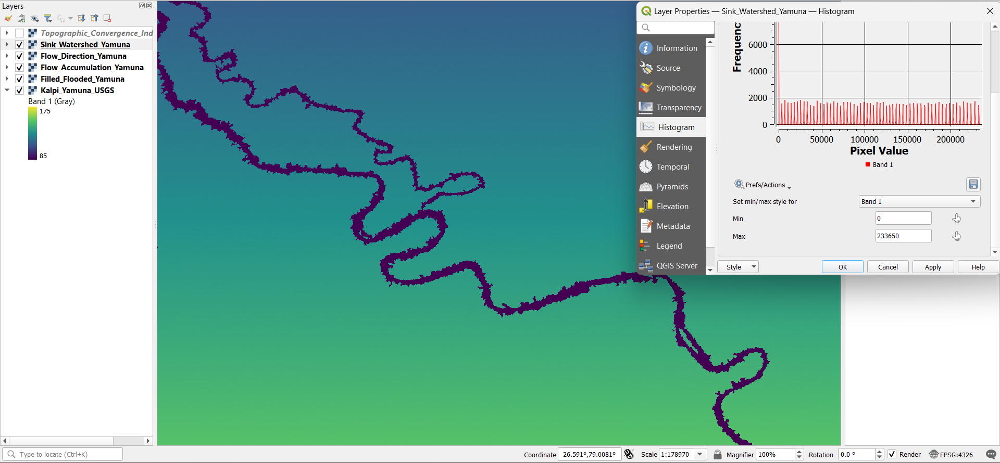

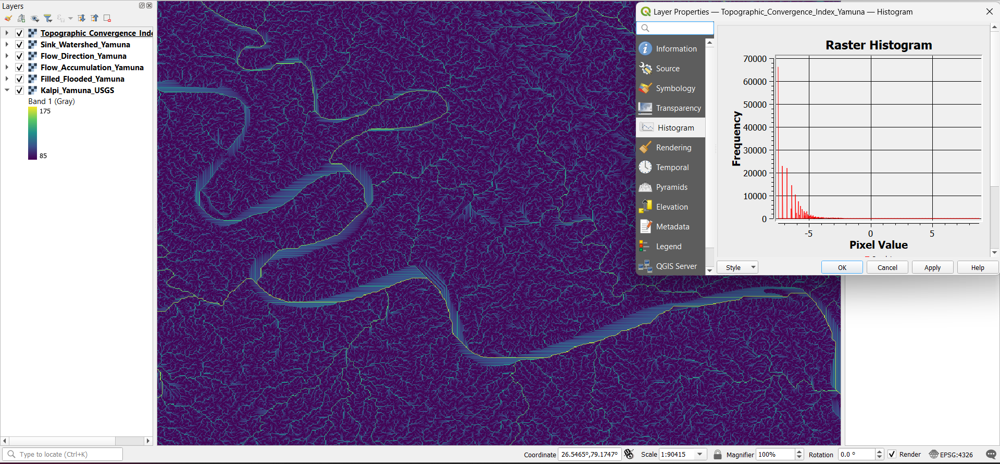

In [ ]:
import xarray as xr
import rasterio

# Load the ground track data
netcdf_file = "C:/Users/HP/Downloads/enhanced_measurement.nc"
ground_track_data = xr.open_dataset(netcdf_file)

# Load the GeoTIFF files
flow_accumulation_file = "C:/Users/HP/OneDrive/Desktop/Surge Project/QGIS Files 1/Flow_Accumulation_Yamuna.tif"
flow_direction_file = "C:/Users/HP/OneDrive/Desktop/Surge Project/QGIS Files 1/Flow_Direction_Yamuna.tif"
sink_watershed_file = "C:/Users/HP/OneDrive/Desktop/Surge Project/QGIS Files 1/Sink_Watershed_Yamuna.tif"
topographic_convergence_file = "C:/Users/HP/OneDrive/Desktop/Surge Project/QGIS Files 1/Topographic_Convergence_Index_Yamuna.tif"

# Open the GeoTIFF files
flow_accumulation_data = rasterio.open(flow_accumulation_file)
flow_direction_data = rasterio.open(flow_direction_file)
sink_watershed_data = rasterio.open(sink_watershed_file)
topographic_convergence_data = rasterio.open(topographic_convergence_file)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Threshold value for flow accumulation to determine river network
threshold_value = 10

# Read the flow accumulation data as a numpy array
flow_accumulation_array = flow_accumulation_data.read(1)

# Apply thresholding to extract the river network
river_network = np.where(flow_accumulation_array >= threshold_value, 1, 0)

# Create a figure and axes
fig, ax = plt.subplots()

# Display the river network array
choice = 'Blues'
ax.imshow(river_network, cmap=choice)

# Add a colorbar for reference
cbar = plt.colorbar(ax.imshow(river_network, cmap=choice), ax=ax)

# Show the plot
plt.show()

# Find the outlet point coordinates
outlet_points = np.where(river_network == 1)

# Get the first outlet point coordinates
outlet_latitude = outlet_points[0][0]
outlet_longitude = outlet_points[1][0]

# Print the coordinates of the outlet point
print("Outlet Point Coordinates:")
print("Latitude:", outlet_latitude)
print("Longitude:", outlet_longitude)


In [ ]:
# Threshold value for flow accumulation to determine river network
threshold_value = 10

# Read the flow accumulation data as a numpy array
flow_accumulation_array = flow_accumulation_data.read(1)

# Convert the flow accumulation array to logarithmic scale
log_flow_accumulation = np.log(flow_accumulation_array)

# Apply thresholding to extract the river network
river_network = np.where(flow_accumulation_array >= threshold_value, 1, 0)

# Create a figure and axis
fig, ax = plt.subplots()

# Plot the log flow accumulation array plot thr flow accumu
im = ax.imshow(river_network, cmap='binary')

# Add a colorbar to the plot
cbar = plt.colorbar(im, ax=ax)

# Add title and labels to the plot
ax.set_title('Flow Accumulation (Log Scale)')

# Show the plot
plt.show()


In [ ]:
import cv2

# Apply thresholding to extract the river network
river_network = np.where(flow_accumulation_array >= threshold_value, 1, 0)

# Find contours in the binary image using cv2.RETR_CCOMP retrieval mode
contours, hierarchy = cv2.findContours(river_network.astype(np.uint8), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

# Create an empty list to store the vectorized river network
vector_lines = []

# Iterate over each contour
for contour in contours:
    # Approximate the contour to reduce the number of vertices
    epsilon = 0.01 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
    
    # Append the simplified contour as a line to the vector lines list
    vector_lines.append(approx.squeeze())

# Create a new figure
fig, ax = plt.subplots()

# Iterate over each line segment in 'vector_lines'
for line in vector_lines:
    # Check if the line segment has more than one point (is 2-dimensional)
    if line.ndim == 2 and line.shape[0] > 1:
        # Extract x and y coordinates from the line segment
        x = line[:, 0]
        y = line[:, 1]

        # Plot the line segment
        ax.plot(x, y, color='blue')

# Set the aspect ratio and axis labels
ax.set_aspect('equal')

# Display the plot
plt.show()


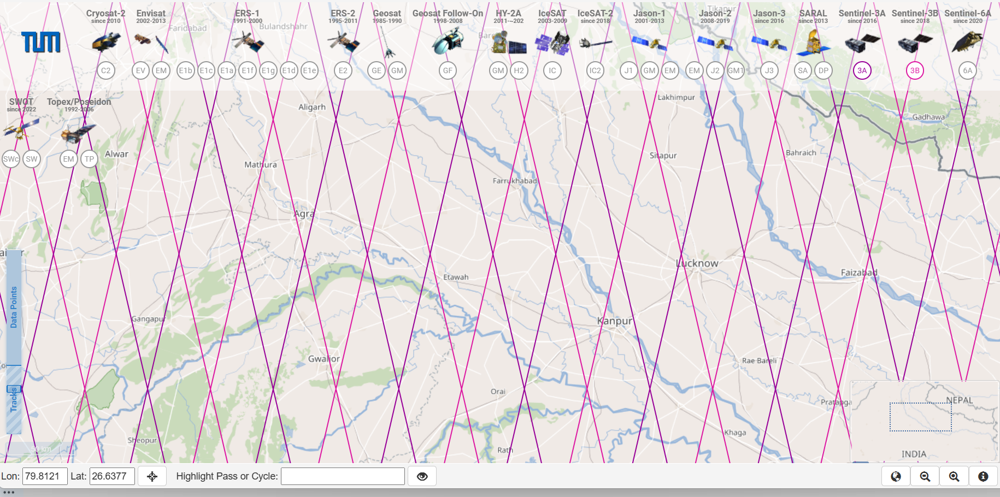

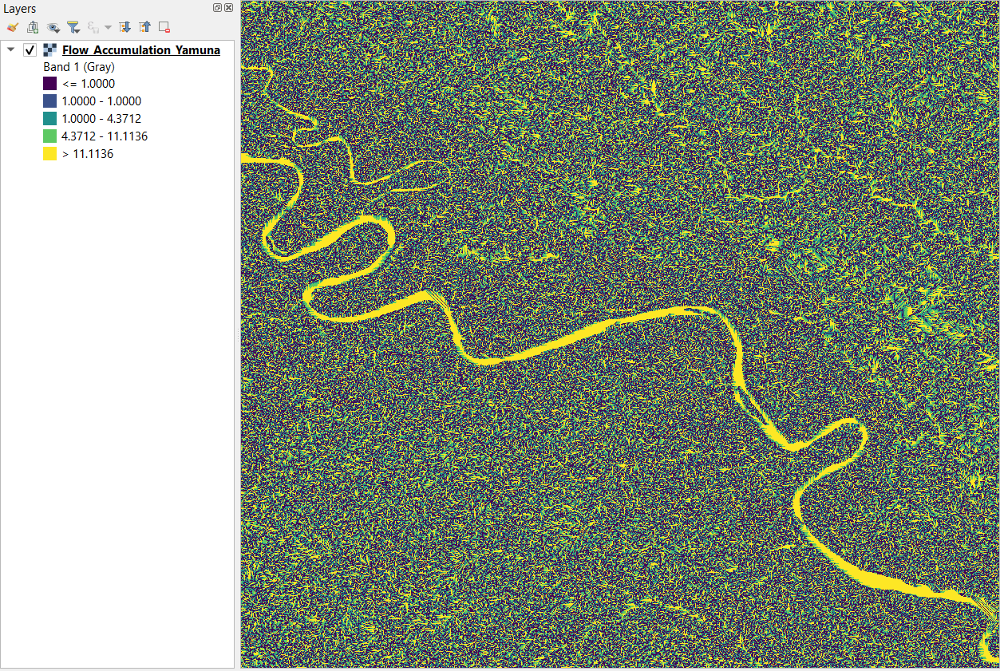

In [ ]:
import shapefile

# Specify the path to your .shx file
shx_file_path = 'C:/Users/HP/Downloads/HydroRIVERS_v10_as_shp/HydroRIVERS_v10_as_shp/HydroRIVERS_v10_as.shx'

# Open the .shx file
shx_reader = shapefile.Reader(shx_file_path)

# Get the shapefile fields
fields = shx_reader.fields[1:]  # Exclude the DeletionFlag field
field_names = [field[0] for field in fields]

# Get the shapefile records (attributes)
records = shx_reader.records()

# Get the shapefile shapes (geometry)
shapes = shx_reader.shapes()

# Print the field names
print("Field names:")
print(field_names)

# Print the first few records
print("\nRecords:")
for record in records[:5]:
    print(record)

# Print the first few shapes (geometry)
print("\nShapes (Geometry):")
for shape in shapes[:5]:
    print(shape)
